# Advanced Certification Programme in AI and MLOps
## A programme by IISc and TalentSprint
### Mini-Project: Sentiment Classification on Amazon Food Reviews

## Learning Objectives

At the end of the experiment, you will be able to :

* perform data preprocessing, EDA and feature extraction on the Amazon food review dataset
* train an LSTM model for sentiment classification
* modularize the sentiment classification application

## Dataset description

The dataset consists of reviews of fine foods from amazon. The data span a period of more than 10 years, including all ~500,000 reviews up to October 2012. Reviews include product and user information, ratings, and a plain text review. It also includes reviews from all other Amazon categories.

Data includes reviews from Oct 1999 - Oct 2012 period, with 568454 reviews, 256059 users, 74258 products, and 260 users with more than 50 reviews each.

The data is in CSV format with below features:

- ***Id:*** Row Id
- ***ProductId:*** Unique identifier for the product
- ***UserId:*** Unqiue identifier for the user
- ***ProfileName:*** Profile name of the user
- ***HelpfulnessNumerator:*** Number of users who found the review helpful
- ***HelpfulnessDenominator:*** Number of users who indicated whether they found the review helpful or not
- ***Score:*** Rating between 1 and 5
- ***Time:*** Timestamp for the review
- ***Summary:*** Brief summary of the review
- ***Text:*** Text of the review


##  Grading = 10 Points

## Information

Companies often receive thousands of reviews regarding their products which can be analysed to get incites on what customers think about their products.

Every positive review highlights the beneficial key features of the product, which can be replicated to other products making them more likable. On the other hand, every negative review highlights the weaknesses of the product, which can be treated as feedback to make improvements.

### Import required packages

In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from bs4 import BeautifulSoup
import io
import re
import json
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.preprocessing.text import Tokenizer, tokenizer_from_json
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Input, LSTM, Embedding, Dense
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras import layers

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [3]:
#@title Download the dataset
!wget -q https://cdn.iisc.talentsprint.com/AIandMLOps/MiniProjects/Datasets/Reviews.csv
!ls | grep ".csv"

Reviews.csv


**Exercise 1: Read the Reviews.csv dataset**

**Hint:** pd.read_csv()

In [5]:
df = pd.read_csv("/content/Reviews.csv")
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568438 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB


In [7]:
df.describe()

,Id,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time
count,568454.000000,568454.000000,568454.00000,568454.000000,5.684540e+05
mean,284227.500000,1.743817,2.22881,4.183199,1.296257e+09
std,164098.679298,7.636513,8.28974,1.310436,4.804331e+07
min,1.000000,0.000000,0.00000,1.000000,9.393408e+08
25%,142114.250000,0.000000,0.00000,4.000000,1.271290e+09
50%,284227.500000,0.000000,1.00000,5.000000,1.311120e+09
75%,426340.750000,2.000000,2.00000,5.000000,1.332720e+09
max,568454.000000,866.000000,923.00000,5.000000,1.351210e+09


### Pre-processing and EDA

**Exercise 2: Perform below operations on the dataset [1 Mark]**

- Remove unnecessary columns - 'Id', 'HelpfulnessNumerator', 'HelpfulnessDenominator'
- Check missing values
- Add a new `Sentiment` column using `Score` column ('positive' if score >=3)
- Remove duplicates from data considering `Sentiment` and `Text` columns
- Change `Time` in proper format


- **Remove unnecessary columns - 'Id', 'HelpfulnessNumerator', 'HelpfulnessDenominator'**

In [8]:
# Use drop to remove the columns -  'Id', 'HelpfulnessNumerator', 'HelpfulnessDenominator'
df = df.drop(df[['Id','HelpfulnessNumerator','HelpfulnessDenominator']], axis=1)
df.head()

,ProductId,UserId,ProfileName,Score,Time,Summary,Text
0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,B00813GRG4,A1D87F6ZCVE5NK,dll pa,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,B000UA0QIQ,A395BORC6FGVXV,Karl,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


- **Check missing values**

In [9]:
df.isnull().sum()

ProductId       0
UserId          0
ProfileName    16
Score           0
Time            0
Summary        27
Text            0
dtype: int64

- **Add a new `Sentiment` column using `Score` column**

Consider a review to be negative is the score is less than 3, else positive.

In [10]:
df['Sentiment'] = df['Score'].apply(lambda x:'P' if x > 2 else 'N')

In [11]:
df.head()

,ProductId,UserId,ProfileName,Score,Time,Summary,Text,Sentiment
0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,P
1,B00813GRG4,A1D87F6ZCVE5NK,dll pa,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,N
2,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,P
3,B000UA0QIQ,A395BORC6FGVXV,Karl,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,N
4,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,P


- **Remove duplicates from data considering `Sentiment` and `Text` columns**

**Hint:** To check duplicates rows, refer [here](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.duplicated.html).

In [12]:
df_new = df.drop_duplicates(subset=['Sentiment', 'Text'], keep='last')

In [13]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 393591 entries, 0 to 568453
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   ProductId    393591 non-null  object
 1   UserId       393591 non-null  object
 2   ProfileName  393580 non-null  object
 3   Score        393591 non-null  int64 
 4   Time         393591 non-null  int64 
 5   Summary      393588 non-null  object
 6   Text         393591 non-null  object
 7   Sentiment    393591 non-null  object
dtypes: int64(2), object(6)
memory usage: 27.0+ MB


- **Change `Time` in proper format**

The Time is in unix time, change it in UTC.

Note: Unix time is a way of representing a timestamp by representing the time as the number of seconds since January 1st, 1970 at 00:00:00 UTC

**Hint:** datetime.fromtimestamp()

In [14]:
df_new['NewTime'] = df_new['Time'].apply(lambda x: pd.Timestamp(datetime.fromtimestamp(x).date(),tz='UTC'))

df_new.head()

<ipython-input-14-efafc659f16d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['NewTime'] = df_new['Time'].apply(lambda x: pd.Timestamp(datetime.fromtimestamp(x).date(),tz='UTC'))


,ProductId,UserId,ProfileName,Score,Time,Summary,Text,Sentiment,NewTime
0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,P,2011-04-27 00:00:00+00:00
1,B00813GRG4,A1D87F6ZCVE5NK,dll pa,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,N,2012-09-07 00:00:00+00:00
2,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,P,2008-08-18 00:00:00+00:00
4,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,P,2012-10-21 00:00:00+00:00
5,B006K2ZZ7K,ADT0SRK1MGOEU,Twoapennything,4,1342051200,Nice Taffy,I got a wild hair for taffy and ordered this f...,P,2012-07-12 00:00:00+00:00


**Exercise 3: Identify the `ProductId`s with highest number of positive and negative reviews. Use barplot. [0.5 Marks]**

In [15]:
#Selecting only specific columns
df_temp = df_new[['ProductId', 'Sentiment', 'UserId']]

#Creating seperate dataframes for positive and negative sentiments
df_new_p = df_temp[df_temp['Sentiment'] =='P']
df_new_n = df_temp[df_temp['Sentiment'] =='N']

In [16]:
dfh_ProductId_p=df_new_p.groupby(['ProductId','Sentiment']).count()
df_ProductId_p = dfh_ProductId_p.sort_values(by=['UserId','ProductId'],ascending=False).head(5)

dfh_ProductId_n=df_new_n.groupby(['ProductId','Sentiment']).count()
df_ProductId_n = dfh_ProductId_n.sort_values(by=['UserId','ProductId'],ascending=False).head(5)

In [17]:
df_ProductId_merged = df_ProductId_p.append(df_ProductId_n,ignore_index=False)
print(df_ProductId_merged)

                      UserId
ProductId  Sentiment        
B007JFMH8M P             894
B003B3OOPA P             610
B002QWP8H0 P             592
B001EO5Q64 P             553
B000NMJWZO P             536
B000KV7ZGQ N             167
B0041NYV8E N             146
B005K4Q34S N             141
B000X1Q1G8 N             141
B003CIBPN8 N             129


<ipython-input-17-d4f7e5384f3c>:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_ProductId_merged = df_ProductId_p.append(df_ProductId_n,ignore_index=False)


<Axes: xlabel='count', ylabel='ProductId'>

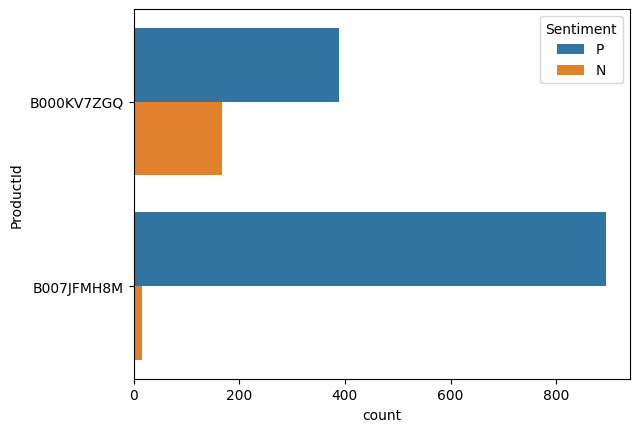

In [18]:
import seaborn as sns
sns.countplot(y = 'ProductId', hue='Sentiment' ,data = df_temp[(df_temp['ProductId'] =='B007JFMH8M') | (df_temp['ProductId'] =='B000KV7ZGQ')])

**Exercise 4: Identify the `UserId`s who has given highest number of positive and negative reviews**

In [19]:
dfh_UserId_p=df_new_p.groupby(['UserId','Sentiment']).count()
df_UserId_p = dfh_UserId_p.sort_values(by=['ProductId','UserId'],ascending=False).head(5)

dfh_UserId_n=df_new_n.groupby(['UserId','Sentiment']).count()
df_UserId_n = dfh_UserId_n.sort_values(by=['ProductId', 'UserId'],ascending=False).head(5)

In [20]:
df_UserId_merged = df_UserId_p.append(df_UserId_n,ignore_index=False)
print(df_UserId_merged)

                          ProductId
UserId         Sentiment           
AY12DBB0U420B  P                324
A3OXHLG6DIBRW8 P                265
A281NPSIMI1C2R P                242
A1Z54EM24Y40LL P                198
A1YUL9PCJR3JTY P                193
AKZKG2Z7CNV27  N                 34
A2M9D9BDHONV3Y N                 30
A2MUGFV2TDQ47K N                 29
A2TN9C5E4A0I3F N                 26
A2XNJJ9TF70P4J N                 25


<ipython-input-20-334b249f9fc6>:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_UserId_merged = df_UserId_p.append(df_UserId_n,ignore_index=False)


<Axes: xlabel='count', ylabel='UserId'>

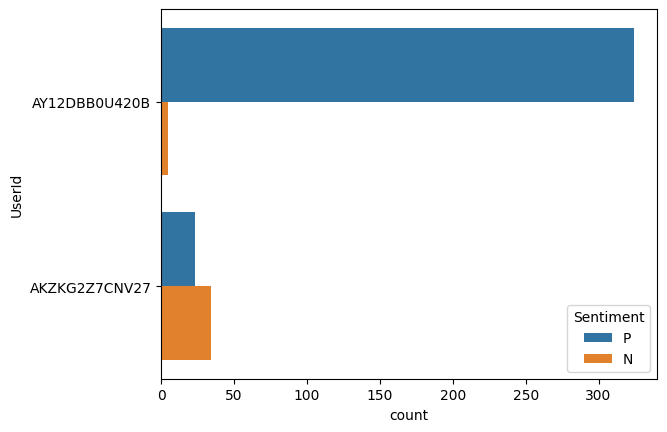

In [21]:
sns.countplot(y = 'UserId', hue='Sentiment' ,data = df_temp[(df_temp['UserId']=="AY12DBB0U420B") | (df_temp['UserId']=='AKZKG2Z7CNV27')])

### Pre-process `Text` reviews

**Exercise 5: Create functions to perform below tasks: [1.5 Marks]**

- remove HTML, XML, etc. markup and metadata
- remove punctuations
- remove stopwords


- **Remove HTML, XML, etc.**


In [22]:
import re
def cleanText(Text):
  Text = Text.lower() # converting to lower case
  Text = re.sub(r'http\S+', '', Text,flags = re.MULTILINE) # remove URLs
  Text = re.sub('RT|cc', '', Text)  # remove RT and cc
  Text = re.sub('#\S+', '', Text)  # remove hashtags
  Text = re.sub('@\S+', '', Text)  # remove mentions
  Text = re.sub('[%s]' % re.escape("""!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~"""), '', Text)  # remove punctuations
  Text = re.sub('â\S+', '', Text)  # remove â¢
  Text = re.sub('+', '', Text)  # remove 
  Text = re.sub('\s+', ' ', Text)  # remove extra whitespace

  return Text

In [23]:
 # apply the function defined above and save the
df_new['Cleaned_Text'] = df['Text'].apply(cleanText)

<ipython-input-23-d208ea118024>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['Cleaned_Text'] = df['Text'].apply(cleanText)


In [24]:
df_new[['Text','Cleaned_Text']].head()

,Text,Cleaned_Text
0,I have bought several of the Vitality canned d...,i have bought several of the vitality canned d...
1,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled as jumbo salted peanut...
2,This is a confection that has been around a fe...,this is a confection that has been around a fe...
4,Great taffy at a great price. There was a wid...,great taffy at a great price there was a wide ...
5,I got a wild hair for taffy and ordered this f...,i got a wild hair for taffy and ordered this f...


- **Remove punctuations**

In [25]:
# Included in the above function

- **Remove stopwords**

In [26]:
# stop words
stopword_list = nltk.corpus.stopwords.words('english')
stopword_list = [word for word in stopword_list if "n't" not in word]
negative = ["no", "not", "nor", "don", "ain", "aren", "couldn", "didn", "doesn", "hadn", "hasn", "isn", "mightn", "mustn", "needn", "shan", "shouldn", "wasn", "weren", "wouldn", "won"]
stopword_list = [word for word in stopword_list if word not in negative]
print(stopword_list)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', 's', '

In [27]:
# removing the stopwords
from nltk.tokenize import word_tokenize

def remove_stopwords(text, is_lower_case=False):
    # splitting strings into tokens (list of words)
    tokens = word_tokenize(text)
    tokens = [token.strip() for token in tokens]
    filtered_tokens = [token for token in tokens if token not in stopword_list]
    filtered_text = ' '.join(filtered_tokens)
    return filtered_text

In [28]:
# apply function on cleaned resume to remove stopwords
df_new['Cleaned_Text'] = df_new['Cleaned_Text'].apply(remove_stopwords)

<ipython-input-28-9b916e9e4c51>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['Cleaned_Text'] = df_new['Cleaned_Text'].apply(remove_stopwords)


In [29]:
df_new[['Text','Cleaned_Text']].head()

,Text,Cleaned_Text
0,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...
1,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...
2,This is a confection that has been around a fe...,confection around centuries light pillowy citr...
4,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...
5,I got a wild hair for taffy and ordered this f...,got wild hair taffy ordered five pound bag taf...


**Exercise 6: Convert `Sentiment` to numerical**

In [30]:
from sklearn.preprocessing import LabelEncoder
targetLabels  = ['P','N']

le = LabelEncoder()
le.fit(targetLabels)

LabelEncoder()

In [31]:
df_new['Target'] = le.transform(df_new['Sentiment'])
df_new

<ipython-input-31-b764888e2772>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new['Target'] = le.transform(df_new['Sentiment'])


,ProductId,UserId,ProfileName,Score,Time,Summary,Text,Sentiment,NewTime,Cleaned_Text,Target
0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,P,2011-04-27 00:00:00+00:00,bought several vitality canned dog food produc...,1
1,B00813GRG4,A1D87F6ZCVE5NK,dll pa,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,N,2012-09-07 00:00:00+00:00,product arrived labeled jumbo salted peanutsth...,0
2,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,P,2008-08-18 00:00:00+00:00,confection around centuries light pillowy citr...,1
4,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,P,2012-10-21 00:00:00+00:00,great taffy great price wide assortment yummy ...,1
5,B006K2ZZ7K,ADT0SRK1MGOEU,Twoapennything,4,1342051200,Nice Taffy,I got a wild hair for taffy and ordered this f...,P,2012-07-12 00:00:00+00:00,got wild hair taffy ordered five pound bag taf...,1
...,...,...,...,...,...,...,...,...,...,...,...
568449,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,5,1299628800,Will not do without,Great for sesame chicken..this is a good if no...,P,2011-03-09 00:00:00+00:00,great sesame chickenthis good not better restu...,1
568450,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,2,1331251200,disappointed,I'm disappointed with the flavor. The chocolat...,N,2012-03-09 00:00:00+00:00,im disappointed flavor chocolate notes especia...,0
568451,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",5,1329782400,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o...",P,2012-02-21 00:00:00+00:00,stars small give 1015 one training session tri...,1
568452,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",5,1331596800,Favorite Training and reward treat,These are the BEST treats for training and rew...,P,2012-03-13 00:00:00+00:00,best treats training rewarding dog good groomi...,1


### Split data into train, validation, and test set

Use 60% for training, 20% for validation, and 20% for testing.

In [32]:
# Split the dataset into training and testing sets
X_train_temp, X_test, y_train_temp, y_test = train_test_split(df_new['Cleaned_Text'].values, df_new['Target'].values,
                                                    test_size=0.20,
                                                    random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_temp, y_train_temp,
                                                    test_size=0.25,
                                                    random_state=42)

len(X_train), len(X_test), len(X_val), len(y_train), len(y_test), len(y_val)

(236154, 78719, 78718, 236154, 78719, 78718)

### Tokenization and padding

**Exercise 7: Convert the review text to sequence of integer values, and make them of uniform length [0.5 Marks]**

In [33]:
# Tokenizer class from the keras.preprocessing.text module creates a word-to-index dictionary
tokenizer = Tokenizer(num_words=5000)
tokenizer.fit_on_texts(X_train)

X_train_tok = tokenizer.texts_to_sequences(X_train)
X_val_tok = tokenizer.texts_to_sequences(X_val)
X_test_tok = tokenizer.texts_to_sequences(X_test)

In [34]:
# Find the vocabulary size and perform padding on both train and test set
vocab_size = len(tokenizer.word_index) + 1

maxlen = 100

X_train_pad = pad_sequences(X_train_tok, padding='post', maxlen=maxlen, truncating='post')
X_val_pad = pad_sequences(X_val_tok, padding='post', maxlen=maxlen, truncating='post')
X_test_pad = pad_sequences(X_test_tok, padding='post', maxlen=maxlen, truncating='post')

In [35]:
X_train_pad

array([[  13,  397,  215, ...,    0,    0,    0],
       [   3,   35,  461, ...,    0,    0,    0],
       [  92, 1433,   30, ...,    0,    0,    0],
       ...,
       [   3,    8,  212, ...,    0,    0,    0],
       [ 328, 1028,  391, ...,    0,    0,    0],
       [3231,  124, 3035, ...,    0,    0,    0]], dtype=int32)

**Exercise 8: Save the Tokenizer fitted on training set in a json file, and load it back [0.5 Marks]**

**Hint:**

- To get json string from tokenizer, refer [here](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer#to_json).
- To save json string in a json file: `json.dumps()`
- To load json string from a json file: `json.load()`
- To get a tokenizer instance from json string, refer [here](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/tokenizer_from_json).

In [47]:
tokenizer.to_json()

'{"class_name": "Tokenizer", "config": {"num_words": 5000, "filters": "!\\"#$%&()*+,-./:;<=>?@[\\\\]^_`{|}~\\t\\n", "lower": true, "split": " ", "char_level": false, "oov_token": null, "document_count": 236154, "word_counts": "{\\"love\\": 49571, \\"nuts\\": 4555, \\"dark\\": 8281, \\"chocolate\\": 26359, \\"no\\": 43068, \\"brainer\\": 96, \\"arent\\": 3283, \\"big\\": 10764, \\"enough\\": 13594, \\"meal\\": 6071, \\"replacement\\": 1705, \\"personally\\": 1887, \\"dieting\\": 207, \\"trying\\": 8761, \\"whats\\": 1364, \\"right\\": 13961, \\"eat\\": 25362, \\"breakfast\\": 6112, \\"hurry\\": 341, \\"great\\": 67179, \\"option\\": 2382, \\"still\\": 18248, \\"eating\\": 11938, \\"chewy\\": 3363, \\"granola\\": 3266, \\"bars\\": 8952, \\"dont\\": 38941, \\"think\\": 19898, \\"time\\": 33656, \\"adult\\": 1106, \\"bar\\": 7479, \\"taste\\": 69465, \\"get\\": 44095, \\"crunch\\": 2443, \\"sweet\\": 21058, \\"smooth\\": 5882, \\"sweets\\": 557, \\"favorite\\": 15460, \\"companion\\": 136,

In [49]:
# Get json string from tokenizer
with open('senti.json','w') as out:
  json.dump(tokenizer.to_json(),out)

In [50]:
# Get tokenizer instance from json string
with open('senti.json','r') as out:
  json_string=json.load(out)
  readTokenizer=tokenizer_from_json(json_string)

### Build the model using LSTM

**Exercise 9: Create a model using Embedding, LSTM, and Dense layers for sentiment classification [1 Mark]**

In [43]:
EMBEDDING_DIM = 32

print('Build model...')

model = Sequential()
model.add(Embedding(input_dim = vocab_size, output_dim = EMBEDDING_DIM, input_length=maxlen, mask_zero=True))
model.add(LSTM(units=40,  dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))

# Try using different optimizers and different optimizer configs
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

print('Summary of the built model...')
print(model.summary())

Build model...
Summary of the built model...
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 100, 32)           5439968   
                                                                 
 lstm_2 (LSTM)               (None, 40)                11680     
                                                                 
 dense_2 (Dense)             (None, 1)                 41        
                                                                 
Total params: 5,451,689
Trainable params: 5,451,689
Non-trainable params: 0
_________________________________________________________________
None


**Exercise 10: Train and evaluate the model**

In [44]:
history = model.fit(X_train_pad, y_train, batch_size=128, epochs=1, verbose=1, validation_data=(X_val_pad, y_val))

1845/1845 [==============================] - 659s 355ms/step - loss: 0.2359 - accuracy: 0.9040 - val_loss: 0.2170 - val_accuracy: 0.9099


In [45]:
print('Testing...')
y_test = np.array(y_test)
score, acc = model.evaluate(X_test_pad, y_test, batch_size=128)

print('Test score:', score)
print('Test accuracy:', acc)

print("Accuracy: {0:.2%}".format(acc))

Testing...
615/615 [==============================] - 27s 43ms/step - loss: 0.2157 - accuracy: 0.9109
Test score: 0.21573837101459503
Test accuracy: 0.910910964012146
Accuracy: 91.09%


### Test Prediction

Create function to get sentiment prediction for user input data.

In [46]:
#Let us test some  samples
test_sample_1 = "This taffy is fantastic! I really like it because it is so good!"
test_sample_2 = "Good quality dog food!"
test_sample_3 = "Maybe I like this Cookie."
test_sample_4 = "Not to my taste, will skip and eat another snacks"
test_sample_5 = "if you have cold you should purchase cough medicine from Amazon."
test_sample_6 = "Bad quality dog food!"
test_sample_7 = "Not a good taffy!"
test_sample_8 = "This dog food is not good! Can I get my money back please?"
test_samples = [test_sample_1, test_sample_2, test_sample_3, test_sample_4, test_sample_5, test_sample_6, test_sample_7, test_sample_8]

test_samples_tokens = tokenizer.texts_to_sequences(test_samples)
test_samples_tokens_pad = pad_sequences(test_samples_tokens, maxlen=maxlen)

# predict
pred = model.predict(x=test_samples_tokens_pad)
pred

1/1 [==============================] - 1s 571ms/step


array([[0.98296857],
       [0.87019926],
       [0.50393784],
       [0.26500833],
       [0.743108  ],
       [0.62074804],
       [0.6006518 ],
       [0.33966494]], dtype=float32)

## Modularization [5 points]

- Modularize the above sentiment classification application for Amazon food reviews dataset as per instructions given in the Instructions document